# Overview

This notebook contains both the raw osm xml download as well as the processing code for osm2streets. 

Based on these trials, I wrote the `sidewalk_generator.py`. This notebook should serve as a reference for future iterations, or if intermediary steps are required.

## Downloading and tiling raw oxm xml
Query courtesy of momepy. 


### Download in a single osm xml

In [ ]:
from geopy.geocoders import Nominatim
import requests
from time import sleep

# Initialize geolocator and API
geolocator = Nominatim(user_agent="osm2streets_python/0.1.0 (l.r.n.beuster@tudelft.nl)")
# overpass_url = "http://overpass-api.de/api/interpreter"
overpass_url = "https://lz4.overpass-api.de/api/interpreter"

## Alternative: https://z.overpass-api.de/api/interpreter


# Get city bounding box
location = geolocator.geocode("West, Amsterdam")
if location:
    print("Location found, processing...")
    # Convert bounding box values to floats to avoid any type issues
    bbox = (float(location.raw['boundingbox'][0]), float(location.raw['boundingbox'][2]), 
            float(location.raw['boundingbox'][1]), float(location.raw['boundingbox'][3]))
    print(bbox)

    # Construct the Overpass query
    ways_and_nodes_query = f"""
    [out:xml];
    (
    way["highway"]["area"!~"yes"]["highway"!~"abandoned|construction|no|planned|platform|proposed|raceway|razed"]
    ({bbox[0]}, {bbox[1]}, {bbox[2]}, {bbox[3]});
    >;);
    out;
    """

    # Send the request to Overpass and fetch XML response
    sleep(1)  # Add delay between requests
    headers = {
        "User-Agent": "osm2streets_python/0.1.0 (l.r.n.beuster@tudelft.nl)",
    }

    response = requests.post(overpass_url, data=ways_and_nodes_query, headers=headers)

    if response.status_code == 200:
        print("Ways and nodes fetched successfully!")
        with open("../data/raw_data/osm2streets/export_small.osm", "w") as f:
            f.write(response.text)
        print("OSM XML data saved")
    else:
        print(f"Error fetching data: {response.status_code}")

else:
    print("City not found.")

Location found, processing...
(52.3564077, 4.8353311, 52.3993769, 4.8950776)
Ways and nodes fetched successfully!
OSM XML data saved


### Download osm network xml tiled based on nomatim query

In [ ]:
from geopy.geocoders import Nominatim
import osm2streets_python
import geopandas as gpd
import pandas as pd
import json
import os

os.environ["RUST_LOG"] = "off"

# Initialize geolocator
geolocator = Nominatim(user_agent="osm2streets_python/0.1.0 (l.r.n.beuster@tudelft.nl)")

# Query for location and extract OSMID
location_name = "West, Amsterdam"
location = geolocator.geocode(location_name)

if location:
    print(f"Location found: {location.address}")
    
    # Extract OSMID from the raw data
    osmid = location.raw.get("osm_id", None)
    if osmid:
        print(f"OSMID: {osmid}")
        
        # Create subfolder for the OSMID
        base_output_dir = f"../data/raw_data/osm2streets/{osmid}"
        os.makedirs(base_output_dir, exist_ok=True)
        tile_dir = os.path.join(base_output_dir, "tiles")
        os.makedirs(tile_dir, exist_ok=True)
        
            
        # Convert bounding box values to floats to avoid type issues
        min_lat, max_lat = float(location.raw['boundingbox'][0]), float(location.raw['boundingbox'][1])
        min_lon, max_lon = float(location.raw['boundingbox'][2]), float(location.raw['boundingbox'][3])
        
        # Generate tiles
        lat_steps = int((max_lat - min_lat) / tile_size) + 1
        lon_steps = int((max_lon - min_lon) / tile_size) + 1

        print(f"Creating {lat_steps * lon_steps} tiles...")
        
        if len(os.listdir(tile_dir)) != (lat_steps * lon_steps):
            tile_count = 0
            for i in range(lat_steps):
                for j in range(lon_steps):
                    tile_min_lat = min_lat + i * tile_size
                    tile_max_lat = min(tile_min_lat + tile_size, max_lat)
                    tile_min_lon = min_lon + j * tile_size
                    tile_max_lon = min(tile_min_lon + tile_size, max_lon)

                    # Construct the Overpass query
                    bbox = (tile_min_lat, tile_min_lon, tile_max_lat, tile_max_lon)
                    ways_and_nodes_query = f"""
                    [out:xml];
                    (
                    way["highway"]["area"!~"yes"]["highway"!~"abandoned|construction|no|planned|platform|proposed|raceway|razed"]
                    ({bbox[0]}, {bbox[1]}, {bbox[2]}, {bbox[3]});
                    >;);
                    out;
                    """

                    # Send the request to Overpass
                    sleep(1)  # Add delay between requests
                    headers = {
                        "User-Agent": "osm2streets_python/0.1.0 (l.r.n.beuster@tudelft.nl)",
                    }

                    response = requests.post(overpass_url, data=ways_and_nodes_query, headers=headers)
                    
                    if response.status_code == 200:
                        print(f"Tile {tile_count + 1}/{lat_steps * lon_steps} fetched successfully!")
                        file_name = os.path.join(tile_dir, f"{osmid}_tile_{tile_count}.osm")
                        with open(file_name, "w") as f:
                            f.write(response.text)
                        tile_count += 1
                    else:
                        print(f"Error fetching tile {tile_count + 1}: {response.status_code}")

        else:
            print(f"Files for {osmid} are already tiled and downloaded. Skipping download for now")

        # Directory to store processed GeoDataFrames
        processed_dir = os.path.join(base_output_dir, "processed")
        os.makedirs(processed_dir, exist_ok=True)

        # Load and process tiles (as in the previous script)
        combined_gdf = gpd.GeoDataFrame()
        combined_gdf_lanes = gpd.GeoDataFrame()
        combined_gdf_intersections = gpd.GeoDataFrame()
        
        # Input options for osm2streets
        input_options = {
            "debug_each_step": False,
            "dual_carriageway_experiment": False,
            "sidepath_zipping_experiment": False,
            "inferred_sidewalks": True,
            "inferred_kerbs": True,
            "date_time": None,
            "override_driving_side": "Right"
        }
        input_options_json = json.dumps(input_options)

        # Process each tile
        for tile_file in os.listdir(tile_dir):
            tile_path = os.path.join(tile_dir, tile_file)
            
            if tile_file.endswith(".osm"):
                print(f"Processing tile: {tile_file}")
                
                # Load OSM XML data
                with open(tile_path, "rb") as file:
                    osm_input = file.read()

                try:
                    # Initialize PyStreetNetwork
                    network = osm2streets_python.PyStreetNetwork(osm_input, "", input_options_json)
                    print("PyStreetNetwork instance created successfully!")
                    
                    # Generate GeoJSON outputs
                    geojson_output = network.to_geojson_plain()
                    geojson_lane_output = network.to_lane_polygons_geojson()
                    geojson_intersection_output = network.to_intersection_markings_geojson()
                    
                    # Convert to GeoDataFrames
                    gdf = gpd.GeoDataFrame.from_features(json.loads(geojson_output)["features"], crs=4326)
                    gdf_lanes = gpd.GeoDataFrame.from_features(json.loads(geojson_lane_output)["features"], crs=4326)
                    gdf_intersections = gpd.GeoDataFrame.from_features(json.loads(geojson_intersection_output)["features"], crs=4326)
                    
                    # Append to combined GeoDataFrames
                    combined_gdf = gpd.GeoDataFrame(pd.concat([combined_gdf, gdf], ignore_index=True))
                    combined_gdf_lanes = gpd.GeoDataFrame(pd.concat([combined_gdf_lanes, gdf_lanes], ignore_index=True))
                    combined_gdf_intersections = gpd.GeoDataFrame(pd.concat([combined_gdf_intersections, gdf_intersections], ignore_index=True))
                
                except Exception as e:
                    print(f"Error processing {tile_file}: {e}")
        
        # Save combined GeoDataFrames to the OSMID-specific folder
        combined_gdf.to_file(os.path.join(processed_dir, f"{osmid}_combined_network.geojson"), driver="GeoJSON")
        combined_gdf_lanes.to_file(os.path.join(processed_dir, f"{osmid}_combined_lanes.geojson"), driver="GeoJSON")
        combined_gdf_intersections.to_file(os.path.join(processed_dir, f"{osmid}_combined_intersections.geojson"), driver="GeoJSON")
        
        print(f"All data for {location_name} (OSMID: {osmid}) saved successfully!")
    else:
        print(f"OSMID not found for location: {location_name}")
else:
    print(f"Location not found: {location_name}")

Location found: West, Amsterdam, Noord-Holland, Nederland
OSMID: 15419236
Creating 30 tiles...
Tile 1/30 fetched successfully!
Tile 2/30 fetched successfully!
Tile 3/30 fetched successfully!
Tile 4/30 fetched successfully!
Tile 5/30 fetched successfully!
Tile 6/30 fetched successfully!
Tile 7/30 fetched successfully!
Tile 8/30 fetched successfully!
Tile 9/30 fetched successfully!
Tile 10/30 fetched successfully!
Tile 11/30 fetched successfully!
Tile 12/30 fetched successfully!
Tile 13/30 fetched successfully!
Tile 14/30 fetched successfully!
Tile 15/30 fetched successfully!
Tile 16/30 fetched successfully!
Tile 17/30 fetched successfully!
Tile 18/30 fetched successfully!
Tile 19/30 fetched successfully!
Tile 20/30 fetched successfully!
Tile 21/30 fetched successfully!
Tile 22/30 fetched successfully!
Tile 23/30 fetched successfully!
Tile 24/30 fetched successfully!
Tile 25/30 fetched successfully!
Tile 26/30 fetched successfully!
Tile 27/30 fetched successfully!
Tile 28/30 fetched succ

## Processing osm xml files with osm2streets_python

### Process single osm xml with osm2streets_python

In [ ]:
# Cell 1: Import module
import osm2streets_python
import geopandas as gpd
import json
print("osm2streets_python imported successfully.")

# Cell 2: Load OSM XML data as bytes
osm_file_path = "../data/raw_data/osm2streets/export_small.osm"
with open(osm_file_path, "rb") as file:
    osm_input = file.read()
print(f"Loaded {len(osm_input)} bytes from {osm_file_path}.")

# Cell 3: Define input options
clip_pts_geojson = ""  # Empty string to process the whole network

input_options = {
    "debug_each_step": False,
    "dual_carriageway_experiment": False,  # Try toggling this to see if it helps
    "sidepath_zipping_experiment": False,  # Try toggling this as well
    "inferred_sidewalks": True,          # This can also impact geometry processing
    "inferred_kerbs": True,
    "date_time": None,
    "override_driving_side": "Right"
}

# Convert input_options to a JSON string
input_options_json = json.dumps(input_options)

# Initialize PyStreetNetwork with the JSON string for input_options
try:
    network = osm2streets_python.PyStreetNetwork(osm_input, clip_pts_geojson, input_options_json)
    print("PyStreetNetwork instance created successfully!")
except Exception as e:
    print(f"Error during initialization: {e}")

try:
    geojson_output = network.to_geojson_plain()
    print("GeoJSON output successfully generated!")
    # Optionally save it to a file for further inspection
    with open("../data/raw_data/o2s_output.geojson", "w") as f:
        f.write(geojson_output)
except Exception as e:
    print(f"Error calling to_geojson_plain: {e}")


try:
    geojson_lane_output = network.to_lane_polygons_geojson()
    print("Lane GeoJSON output successfully generated!")
    # Optionally save it to a file for further inspection
    with open("../data/raw_data/o2s_lane_output.geojson", "w") as f:
        f.write(geojson_lane_output)
except Exception as e:
    print(f"Error calling to_geojson_plain: {e}")


try:
    geojson_intersection_output = network.to_intersection_markings_geojson()
    print("Lane GeoJSON output successfully generated!")
    # Optionally save it to a file for further inspection
    with open("../data/raw_data/o2s_intersection_output.geojson", "w") as f:
        f.write(geojson_intersection_output)
except Exception as e:
    print(f"Error calling to_geojson_plain: {e}")

# Parse the geojson_output as a dictionary
geojson_data = json.loads(geojson_output)

# Convert the dictionary to a GeoDataFrame
gdf = gpd.GeoDataFrame.from_features(geojson_data["features"], crs=4326)
# gdf = gpd.GeoDataFrame.from_features(geojson_data["features"])

geojson_lane_data = json.loads(geojson_lane_output)

# Convert the dictionary to a GeoDataFrame
gdf_lanes = gpd.GeoDataFrame.from_features(geojson_lane_data["features"], crs=4326)

# Display the first few rows to inspect the data
gdf.head()

geojson_intersection_data = json.loads(geojson_intersection_output)

# Convert the dictionary to a GeoDataFrame
gdf_intersections = gpd.GeoDataFrame.from_features(geojson_intersection_data["features"], crs=4326)

# Display the first few rows to inspect the data
gdf.head()

osm2streets_python imported successfully.
Loaded 1224465 bytes from ../data/raw_data/osm2streets/export_small.osm.


[2024-11-15T18:59:25Z ERROR streets_reader::split_ways] Skipping Road #1043: PL with total length 114.641m and 5 pts has dupe non-adjacent pts
[2024-11-15T18:59:25Z ERROR osm2streets::operations::update_geometry] Road #76 got trimmed into oblivion, collapse it later
[2024-11-15T18:59:25Z ERROR osm2streets::operations::update_geometry] Road #195 got trimmed into oblivion, collapse it later
[2024-11-15T18:59:25Z ERROR osm2streets::operations::update_geometry] Road #235 got trimmed into oblivion, collapse it later
[2024-11-15T18:59:25Z ERROR osm2streets::operations::update_geometry] Road #2406 got trimmed into oblivion, collapse it later
[2024-11-15T18:59:25Z ERROR osm2streets::operations::update_geometry] Road #357 got trimmed into oblivion, collapse it later
[2024-11-15T18:59:25Z ERROR osm2streets::operations::update_geometry] Road #367 got trimmed into oblivion, collapse it later
[2024-11-15T18:59:25Z ERROR osm2streets::operations::update_geometry] Road #1421 got trimmed into oblivion,

PyStreetNetwork instance created successfully!
GeoJSON output successfully generated!
Lane GeoJSON output successfully generated!


[2024-11-15T18:59:26Z ERROR osm2streets::render::intersection_markings] Intersection [NodeID(3124625508), NodeID(3124625514)] has no edges


Lane GeoJSON output successfully generated!


,geometry,dst_i,id,layer,osm_way_ids,src_i,type,control,crossing,intersection_kind,movements,osm_node_ids
0,"POLYGON ((10.01915 53.57695, 10.01977 53.57639...",1.0,0,0.0,[3369140],0.0,road,NaN,NaN,NaN,NaN,NaN
1,"POLYGON ((10.01834 53.58301, 10.01708 53.58268...",36.0,1,0.0,[3390609],2.0,road,NaN,NaN,NaN,NaN,NaN
2,"POLYGON ((10.01688 53.58263, 10.01547 53.58225...",1953.0,2,0.0,[3390609],36.0,road,NaN,NaN,NaN,NaN,NaN
3,"POLYGON ((10.0154 53.58223, 10.01388 53.58176,...",2258.0,3,0.0,"[3390609, 3390609]",1953.0,road,NaN,NaN,NaN,NaN,NaN
4,"POLYGON ((10.01376 53.58172, 10.01364 53.58168...",1983.0,5,0.0,[3390609],2258.0,road,NaN,NaN,NaN,NaN,NaN


### Process multiple osm xml tiles with osm2streets_python

In [11]:
import osm2streets_python
import geopandas as gpd
import pandas as pd
import json
import os

# Directory containing OSM tiles
tile_dir = "../data/raw_data/osm2streets/tiles"

# Combined GeoDataFrames
combined_gdf = gpd.GeoDataFrame()
combined_gdf_lanes = gpd.GeoDataFrame()
combined_gdf_intersections = gpd.GeoDataFrame()

# Input options for osm2streets
input_options = {
    "debug_each_step": False,
    "dual_carriageway_experiment": False,
    "sidepath_zipping_experiment": False,
    "inferred_sidewalks": True,
    "inferred_kerbs": True,
    "date_time": None,
    "override_driving_side": "Right"
}
input_options_json = json.dumps(input_options)

# Process each tile
for tile_file in os.listdir(tile_dir):
    tile_path = os.path.join(tile_dir, tile_file)
    
    if tile_file.endswith(".osm"):
        print(f"Processing tile: {tile_file}")
        
        # Load OSM XML data
        with open(tile_path, "rb") as file:
            osm_input = file.read()

        try:
            # Initialize PyStreetNetwork
            network = osm2streets_python.PyStreetNetwork(osm_input, "", input_options_json)
            print("PyStreetNetwork instance created successfully!")
            
            # Generate GeoJSON outputs
            geojson_output = network.to_geojson_plain()
            geojson_lane_output = network.to_lane_polygons_geojson()
            geojson_intersection_output = network.to_intersection_markings_geojson()
            
            # Convert to GeoDataFrames
            gdf = gpd.GeoDataFrame.from_features(json.loads(geojson_output)["features"], crs=4326)
            gdf_lanes = gpd.GeoDataFrame.from_features(json.loads(geojson_lane_output)["features"], crs=4326)
            gdf_intersections = gpd.GeoDataFrame.from_features(json.loads(geojson_intersection_output)["features"], crs=4326)
            
            # Append to combined GeoDataFrames
            combined_gdf = gpd.GeoDataFrame(pd.concat([combined_gdf, gdf], ignore_index=True))
            combined_gdf_lanes = gpd.GeoDataFrame(pd.concat([combined_gdf_lanes, gdf_lanes], ignore_index=True))
            combined_gdf_intersections = gpd.GeoDataFrame(pd.concat([combined_gdf_intersections, gdf_intersections], ignore_index=True))
        
        except Exception as e:
            print(f"Error processing {tile_file}: {e}")

# # Save combined GeoDataFrames to files for further analysis
# output_dir = "../data/processed_data/osm2streets"
# os.makedirs(output_dir, exist_ok=True)

# combined_gdf.to_file(os.path.join(output_dir, "combined_network.geojson"), driver="GeoJSON")
# combined_gdf_lanes.to_file(os.path.join(output_dir, "combined_lanes.geojson"), driver="GeoJSON")
# combined_gdf_intersections.to_file(os.path.join(output_dir, "combined_intersections.geojson"), driver="GeoJSON")

print("All tiles processed and combined GeoDataFrames saved successfully!")

Processing tile: tile_20.osm
PyStreetNetwork instance created successfully!


[2024-11-15T19:23:41Z ERROR streets_reader::split_ways] Skipping Road #15: PL with total length 118.138m and 13 pts has dupe non-adjacent pts
[2024-11-15T19:23:42Z ERROR osm2streets::operations::update_geometry] Road #16 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:42Z ERROR osm2streets::operations::update_geometry] Road #214 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:42Z ERROR osm2streets::operations::update_geometry] Road #359 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:42Z ERROR osm2streets::operations::update_geometry] Road #364 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:42Z ERROR osm2streets::operations::update_geometry] Road #386 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:42Z ERROR osm2streets::operations::update_geometry] Road #570 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:42Z ERROR osm2streets::operations::update_geometry] Road #707 got trimmed into oblivion, co

Processing tile: tile_7.osm
PyStreetNetwork instance created successfully!


[2024-11-15T19:23:42Z ERROR osm2streets::operations::update_geometry] Road #102 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:42Z ERROR osm2streets::operations::update_geometry] Road #127 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:42Z ERROR osm2streets::operations::update_geometry] Road #536 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:42Z ERROR osm2streets::operations::update_geometry] Road #237 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:42Z ERROR osm2streets::operations::update_geometry] Road #381 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:42Z ERROR osm2streets::operations::update_geometry] Road #673 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:42Z ERROR osm2streets::operations::update_geometry] Road #455 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:42Z ERROR osm2streets::operations::update_geometry] Road #513 got trimmed into oblivion, collapse it later


Processing tile: tile_6.osm
PyStreetNetwork instance created successfully!


[2024-11-15T19:23:42Z ERROR streets_reader::split_ways] Skipping Road #54: PL with total length 127.2893m and 13 pts has dupe non-adjacent pts
[2024-11-15T19:23:42Z ERROR streets_reader::split_ways] Skipping Road #188: PL with total length 73.8564m and 7 pts has dupe non-adjacent pts
[2024-11-15T19:23:42Z ERROR streets_reader::split_ways] Skipping Road #676: PL with total length 367.5616m and 5 pts has dupe non-adjacent pts
[2024-11-15T19:23:42Z ERROR osm2streets::operations::update_geometry] Road #210 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:42Z ERROR osm2streets::operations::update_geometry] Road #97 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:42Z ERROR osm2streets::operations::update_geometry] Road #111 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:42Z ERROR osm2streets::operations::update_geometry] Road #374 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:42Z ERROR osm2streets::operations::update_geometry] Roa

Processing tile: tile_21.osm
PyStreetNetwork instance created successfully!


[2024-11-15T19:23:43Z ERROR osm2streets::operations::update_geometry] Road #185 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:43Z ERROR osm2streets::operations::update_geometry] Road #697 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:43Z ERROR osm2streets::operations::update_geometry] Road #303 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:43Z ERROR osm2streets::operations::update_geometry] Road #387 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:43Z ERROR osm2streets::operations::update_geometry] Road #277 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:43Z ERROR osm2streets::operations::update_geometry] Road #21 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:43Z ERROR osm2streets::operations::update_geometry] Road #466 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:43Z ERROR osm2streets::operations::update_geometry] Road #13 got trimmed into oblivion, collapse it later
[2

Processing tile: tile_23.osm
PyStreetNetwork instance created successfully!
Processing tile: tile_4.osm


[2024-11-15T19:23:43Z ERROR osm2streets::render::intersection_markings] Intersection [NodeID(5996680658)] has no edges
[2024-11-15T19:23:43Z ERROR osm2streets::operations::update_geometry] Road #113 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:43Z ERROR osm2streets::operations::update_geometry] Road #136 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:43Z ERROR osm2streets::operations::update_geometry] Road #600 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:43Z ERROR osm2streets::operations::update_geometry] Road #163 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:43Z ERROR osm2streets::operations::update_geometry] Road #248 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:43Z ERROR osm2streets::operations::update_geometry] Road #85 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:43Z ERROR osm2streets::operations::update_geometry] Road #967 got trimmed into oblivion, collapse it later
[2024-1

PyStreetNetwork instance created successfully!


2024-11-15T19:23:43Z ERROR osm2streets::operations::update_geometry] Road #45 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:43Z ERROR osm2streets::operations::update_geometry] Road #330 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:43Z ERROR osm2streets::operations::update_geometry] Road #208 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:43Z ERROR osm2streets::operations::update_geometry] Road #290 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:43Z ERROR osm2streets::operations::update_geometry] Road #776 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:43Z ERROR osm2streets::operations::update_geometry] Road #818 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:43Z ERROR osm2streets::operations::update_geometry] Road #937 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:43Z ERROR osm2streets::operations::update_geometry] Road #600 got trimmed into oblivion, collapse it later
[2

Processing tile: tile_5.osm
PyStreetNetwork instance created successfully!


[2024-11-15T19:23:44Z ERROR osm2streets::operations::update_geometry] Road #709 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:44Z ERROR osm2streets::operations::update_geometry] Road #119 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:44Z ERROR osm2streets::operations::update_geometry] Road #721 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:44Z ERROR osm2streets::operations::update_geometry] Road #611 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:44Z ERROR osm2streets::operations::update_geometry] Road #137 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:44Z ERROR osm2streets::operations::update_geometry] Road #612 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:44Z ERROR osm2streets::operations::update_geometry] Road #236 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:44Z ERROR osm2streets::operations::update_geometry] Road #251 got trimmed into oblivion, collapse it later


Processing tile: tile_22.osm
PyStreetNetwork instance created successfully!


[2024-11-15T19:23:44Z ERROR streets_reader::split_ways] Skipping Road #357: PL with total length 182.6501m and 11 pts has dupe non-adjacent pts
[2024-11-15T19:23:44Z ERROR streets_reader::split_ways] Skipping Road #566: PL with total length 17.511m and 6 pts has dupe non-adjacent pts
[2024-11-15T19:23:44Z ERROR osm2streets::operations::update_geometry] Road #449 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:44Z ERROR osm2streets::operations::update_geometry] Road #50 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:44Z ERROR osm2streets::operations::update_geometry] Road #16 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:44Z ERROR osm2streets::operations::update_geometry] Road #74 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:44Z ERROR osm2streets::operations::update_geometry] Road #285 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:44Z ERROR osm2streets::operations::update_geometry] Road #246 got trimmed i

Processing tile: tile_1.osm
PyStreetNetwork instance created successfully!


9:23:45Z ERROR osm2streets::operations::update_geometry] Road #652 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:45Z ERROR osm2streets::operations::update_geometry] Road #668 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:45Z ERROR osm2streets::operations::update_geometry] Road #107 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:45Z ERROR osm2streets::operations::update_geometry] Road #116 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:45Z ERROR osm2streets::operations::update_geometry] Road #459 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:45Z ERROR osm2streets::operations::update_geometry] Road #744 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:45Z ERROR osm2streets::operations::update_geometry] Road #723 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:45Z ERROR osm2streets::operations::update_geometry] Road #356 got trimmed into oblivion, collapse it later
[2024-11-15T1

Processing tile: tile_26.osm
PyStreetNetwork instance created successfully!
Error processing tile_26.osm: Assigning CRS to a GeoDataFrame without a geometry column is not supported. Supply geometry using the 'geometry=' keyword argument, or by providing a DataFrame with column name 'geometry'
Processing tile: tile_27.osm
PyStreetNetwork instance created successfully!
Processing tile: tile_0.osm


[2024-11-15T19:23:45Z ERROR streets_reader::split_ways] Skipping Road #343: PL with total length 73.863m and 7 pts has dupe non-adjacent pts
[2024-11-15T19:23:45Z ERROR streets_reader::split_ways] Skipping Road #613: PL with total length 39.5584m and 13 pts has dupe non-adjacent pts
[2024-11-15T19:23:45Z ERROR osm2streets::operations::update_geometry] Road #752 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:45Z ERROR osm2streets::operations::update_geometry] Road #149 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:45Z ERROR osm2streets::operations::update_geometry] Road #786 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:45Z ERROR osm2streets::operations::update_geometry] Road #421 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:45Z ERROR osm2streets::operations::update_geometry] Road #176 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:45Z ERROR osm2streets::operations::update_geometry] Road #62 got trimmed 

PyStreetNetwork instance created successfully!
Processing tile: tile_19.osm
PyStreetNetwork instance created successfully!


[2024-11-15T19:23:46Z ERROR streets_reader::split_ways] Skipping Road #143: PL with total length 137.4967m and 5 pts has dupe non-adjacent pts
[2024-11-15T19:23:46Z ERROR osm2streets::operations::update_geometry] Road #33 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:46Z ERROR osm2streets::operations::update_geometry] Road #47 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:46Z ERROR osm2streets::operations::update_geometry] Road #265 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:46Z ERROR osm2streets::operations::update_geometry] Road #325 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:46Z ERROR osm2streets::operations::update_geometry] Road #65 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:46Z ERROR osm2streets::operations::update_geometry] Road #498 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:46Z ERROR osm2streets::geometry] Hack! intersection_polygon(Intersection #1) called with no 

Processing tile: tile_2.osm
PyStreetNetwork instance created successfully!


[2024-11-15T19:23:46Z ERROR osm2streets::operations::update_geometry] Road #153 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:46Z ERROR osm2streets::operations::update_geometry] Road #792 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:46Z ERROR osm2streets::operations::update_geometry] Road #43 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:46Z ERROR osm2streets::operations::update_geometry] Road #843 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:46Z ERROR osm2streets::operations::update_geometry] Road #620 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:46Z ERROR osm2streets::operations::update_geometry] Road #177 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:46Z ERROR osm2streets::operations::update_geometry] Road #188 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:46Z ERROR osm2streets::operations::update_geometry] Road #643 got trimmed into oblivion, collapse it later
[

Processing tile: tile_25.osm
PyStreetNetwork instance created successfully!
Processing tile: tile_24.osm


[2024-11-15T19:23:46Z ERROR streets_reader::split_ways] Skipping Road #102: PL with total length 91.9941m and 5 pts has dupe non-adjacent pts
[2024-11-15T19:23:46Z ERROR osm2streets::operations::update_geometry] Road #302 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:46Z ERROR osm2streets::operations::update_geometry] Road #395 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:46Z ERROR osm2streets::geometry] Hack! intersection_polygon(Intersection #74) called with no roads
[2024-11-15T19:23:46Z ERROR osm2streets::geometry] Hack! intersection_polygon(Intersection #75) called with no roads
[2024-11-15T19:23:46Z ERROR osm2streets::geometry] Hack! intersection_polygon(Intersection #87) called with no roads
[2024-11-15T19:23:46Z ERROR osm2streets::geometry] Hack! intersection_polygon(Intersection #186) called with no roads
[2024-11-15T19:23:46Z ERROR osm2streets::geometry] Hack! intersection_polygon(Intersection #80) called with no roads
[2024-11-15T19:23:46Z 

PyStreetNetwork instance created successfully!
Processing tile: tile_18.osm


[2024-11-15T19:23:47Z ERROR streets_reader::split_ways] Skipping Road #402: PL with total length 172.1446m and 5 pts has dupe non-adjacent pts
[2024-11-15T19:23:47Z ERROR osm2streets::operations::update_geometry] Road #18 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:47Z ERROR osm2streets::operations::update_geometry] Road #8 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:47Z ERROR osm2streets::operations::update_geometry] Road #169 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:47Z ERROR osm2streets::operations::update_geometry] Road #177 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:47Z ERROR osm2streets::operations::update_geometry] Road #1231 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:47Z ERROR osm2streets::operations::update_geometry] Road #1161 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:47Z ERROR osm2streets::operations::update_geometry] Road #226 got trimmed into oblivion, c

PyStreetNetwork instance created successfully!
Processing tile: tile_3.osm
PyStreetNetwork instance created successfully!


[2024-11-15T19:23:47Z ERROR streets_reader::split_ways] Skipping Road #588: PL with total length 81.3534m and 17 pts has dupe non-adjacent pts
[2024-11-15T19:23:47Z ERROR osm2streets::operations::update_geometry] Road #37 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:47Z ERROR osm2streets::operations::update_geometry] Road #184 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:47Z ERROR osm2streets::operations::update_geometry] Road #240 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:47Z ERROR osm2streets::operations::update_geometry] Road #145 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:47Z ERROR osm2streets::operations::update_geometry] Road #172 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:47Z ERROR osm2streets::operations::update_geometry] Road #4 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:47Z ERROR osm2streets::operations::update_geometry] Road #128 got trimmed into oblivion, col

Processing tile: tile_15.osm
PyStreetNetwork instance created successfully!
Processing tile: tile_29.osm
PyStreetNetwork instance created successfully!
Error processing tile_29.osm: Assigning CRS to a GeoDataFrame without a geometry column is not supported. Supply geometry using the 'geometry=' keyword argument, or by providing a DataFrame with column name 'geometry'
Processing tile: tile_28.osm
PyStreetNetwork instance created successfully!
Processing tile: tile_14.osm
PyStreetNetwork instance created successfully!


[2024-11-15T19:23:48Z ERROR osm2streets::operations::update_geometry] Road #112 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:48Z ERROR osm2streets::operations::update_geometry] Road #113 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:48Z ERROR osm2streets::operations::update_geometry] Road #114 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:48Z ERROR osm2streets::operations::update_geometry] Road #115 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:48Z ERROR osm2streets::operations::update_geometry] Road #116 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:48Z ERROR osm2streets::operations::update_geometry] Road #122 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:48Z ERROR osm2streets::operations::update_geometry] Road #124 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:48Z ERROR osm2streets::operations::update_geometry] Road #125 got trimmed into oblivion, collapse it later


Processing tile: tile_16.osm
PyStreetNetwork instance created successfully!


[2024-11-15T19:23:48Z ERROR osm2streets::operations::update_geometry] Road #86 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:49Z ERROR osm2streets::operations::update_geometry] Road #142 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:49Z ERROR osm2streets::operations::update_geometry] Road #227 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:49Z ERROR osm2streets::operations::update_geometry] Road #230 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:49Z ERROR osm2streets::operations::update_geometry] Road #245 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:49Z ERROR osm2streets::operations::update_geometry] Road #660 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:49Z ERROR osm2streets::operations::update_geometry] Road #583 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:49Z ERROR osm2streets::operations::update_geometry] Road #318 got trimmed into oblivion, collapse it later
[

Processing tile: tile_17.osm
PyStreetNetwork instance created successfully!


[2024-11-15T19:23:49Z ERROR streets_reader::split_ways] Skipping Road #391: PL with total length 109.7095m and 6 pts has dupe non-adjacent pts
[2024-11-15T19:23:49Z ERROR osm2streets::operations::update_geometry] Road #109 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:49Z ERROR osm2streets::operations::update_geometry] Road #110 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:49Z ERROR osm2streets::operations::update_geometry] Road #250 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:49Z ERROR osm2streets::operations::update_geometry] Road #267 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:49Z ERROR osm2streets::operations::update_geometry] Road #326 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:49Z ERROR osm2streets::operations::update_geometry] Road #335 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:49Z ERROR osm2streets::operations::update_geometry] Road #553 got trimmed into oblivion, 

Processing tile: tile_13.osm
PyStreetNetwork instance created successfully!


[2024-11-15T19:23:49Z ERROR osm2streets::operations::update_geometry] Road #271 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:49Z ERROR osm2streets::operations::update_geometry] Road #270 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:49Z ERROR osm2streets::operations::update_geometry] Road #887 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:49Z ERROR osm2streets::operations::update_geometry] Road #619 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:49Z ERROR osm2streets::operations::update_geometry] Road #398 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:49Z ERROR osm2streets::operations::update_geometry] Road #896 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:49Z ERROR osm2streets::operations::update_geometry] Road #273 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:49Z ERROR osm2streets::operations::update_geometry] Road #307 got trimmed into oblivion, collapse it later


Processing tile: tile_8.osm
PyStreetNetwork instance created successfully!


[2024-11-15T19:23:50Z ERROR osm2streets::operations::update_geometry] Road #175 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:50Z ERROR osm2streets::operations::update_geometry] Road #81 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:50Z ERROR osm2streets::operations::update_geometry] Road #617 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:50Z ERROR osm2streets::operations::update_geometry] Road #122 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:50Z ERROR osm2streets::operations::update_geometry] Road #391 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:50Z ERROR osm2streets::operations::update_geometry] Road #395 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:50Z ERROR osm2streets::operations::update_geometry] Road #417 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:50Z ERROR osm2streets::operations::update_geometry] Road #422 got trimmed into oblivion, collapse it later
[

Processing tile: tile_12.osm
PyStreetNetwork instance created successfully!


[2024-11-15T19:23:50Z ERROR streets_reader::split_ways] Skipping Road #771: PL with total length 152.9861m and 9 pts has dupe non-adjacent pts
[2024-11-15T19:23:50Z ERROR osm2streets::operations::update_geometry] Road #434 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:50Z ERROR osm2streets::operations::update_geometry] Road #422 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:50Z ERROR osm2streets::operations::update_geometry] Road #186 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:50Z ERROR osm2streets::operations::update_geometry] Road #537 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:50Z ERROR osm2streets::operations::update_geometry] Road #245 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:50Z ERROR osm2streets::operations::update_geometry] Road #312 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:50Z ERROR osm2streets::operations::update_geometry] Road #82 got trimmed into oblivion, c

Processing tile: tile_9.osm
PyStreetNetwork instance created successfully!


[2024-11-15T19:23:51Z ERROR osm2streets::operations::update_geometry] Road #939 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:51Z ERROR osm2streets::operations::update_geometry] Road #215 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:51Z ERROR osm2streets::operations::update_geometry] Road #658 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:51Z ERROR osm2streets::operations::update_geometry] Road #243 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:51Z ERROR osm2streets::operations::update_geometry] Road #84 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:51Z ERROR osm2streets::operations::update_geometry] Road #298 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:51Z ERROR osm2streets::operations::update_geometry] Road #120 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:51Z ERROR osm2streets::operations::update_geometry] Road #349 got trimmed into oblivion, collapse it later
[

Processing tile: tile_10.osm
PyStreetNetwork instance created successfully!


[2024-11-15T19:23:51Z ERROR osm2streets::operations::update_geometry] Road #81 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:51Z ERROR osm2streets::operations::update_geometry] Road #93 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:51Z ERROR osm2streets::operations::update_geometry] Road #100 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:51Z ERROR osm2streets::operations::update_geometry] Road #169 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:51Z ERROR osm2streets::operations::update_geometry] Road #235 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:51Z ERROR osm2streets::operations::update_geometry] Road #288 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:51Z ERROR osm2streets::operations::update_geometry] Road #318 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:51Z ERROR osm2streets::operations::update_geometry] Road #167 got trimmed into oblivion, collapse it later
[2

Processing tile: tile_11.osm
PyStreetNetwork instance created successfully!


[2024-11-15T19:23:52Z ERROR osm2streets::operations::update_geometry] Road #133 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:52Z ERROR osm2streets::operations::update_geometry] Road #312 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:52Z ERROR osm2streets::operations::update_geometry] Road #786 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:52Z ERROR osm2streets::operations::update_geometry] Road #342 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:52Z ERROR osm2streets::operations::update_geometry] Road #527 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:52Z ERROR osm2streets::operations::update_geometry] Road #417 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:52Z ERROR osm2streets::operations::update_geometry] Road #442 got trimmed into oblivion, collapse it later
[2024-11-15T19:23:52Z ERROR osm2streets::operations::update_geometry] Road #886 got trimmed into oblivion, collapse it later


All tiles processed and combined GeoDataFrames saved successfully!


In [ ]:
combined_gdf_lanes.explore(column="type")

In [8]:
for i, feature in enumerate(geojson_data["features"]):
    print(f"Feature {i+1}:")
    for key, value in feature["properties"].items():
        print(f"  {key}: {value}")
    print("-" * 30)

Feature 1:
  dst_i: 263
  id: 0
  layer: 0
  osm_way_ids: [4449179]
  src_i: 0
  type: road
------------------------------
Feature 2:
  dst_i: 1
  id: 1
  layer: 0
  osm_way_ids: [4449179]
  src_i: 263
  type: road
------------------------------
Feature 3:
  dst_i: 363
  id: 2
  layer: 0
  osm_way_ids: [4480498]
  src_i: 2
  type: road
------------------------------
Feature 4:
  dst_i: 3
  id: 3
  layer: 0
  osm_way_ids: [4480498]
  src_i: 363
  type: road
------------------------------
Feature 5:
  dst_i: 104
  id: 6
  layer: 0
  osm_way_ids: [7372104]
  src_i: 6
  type: road
------------------------------
Feature 6:
  dst_i: 439
  id: 7
  layer: 0
  osm_way_ids: [7372104]
  src_i: 104
  type: road
------------------------------
Feature 7:
  dst_i: 80
  id: 8
  layer: 0
  osm_way_ids: [7372104]
  src_i: 439
  type: road
------------------------------
Feature 8:
  dst_i: 301
  id: 9
  layer: 0
  osm_way_ids: [7372104]
  src_i: 80
  type: road
------------------------------
Feature 9:
 

<Axes: >

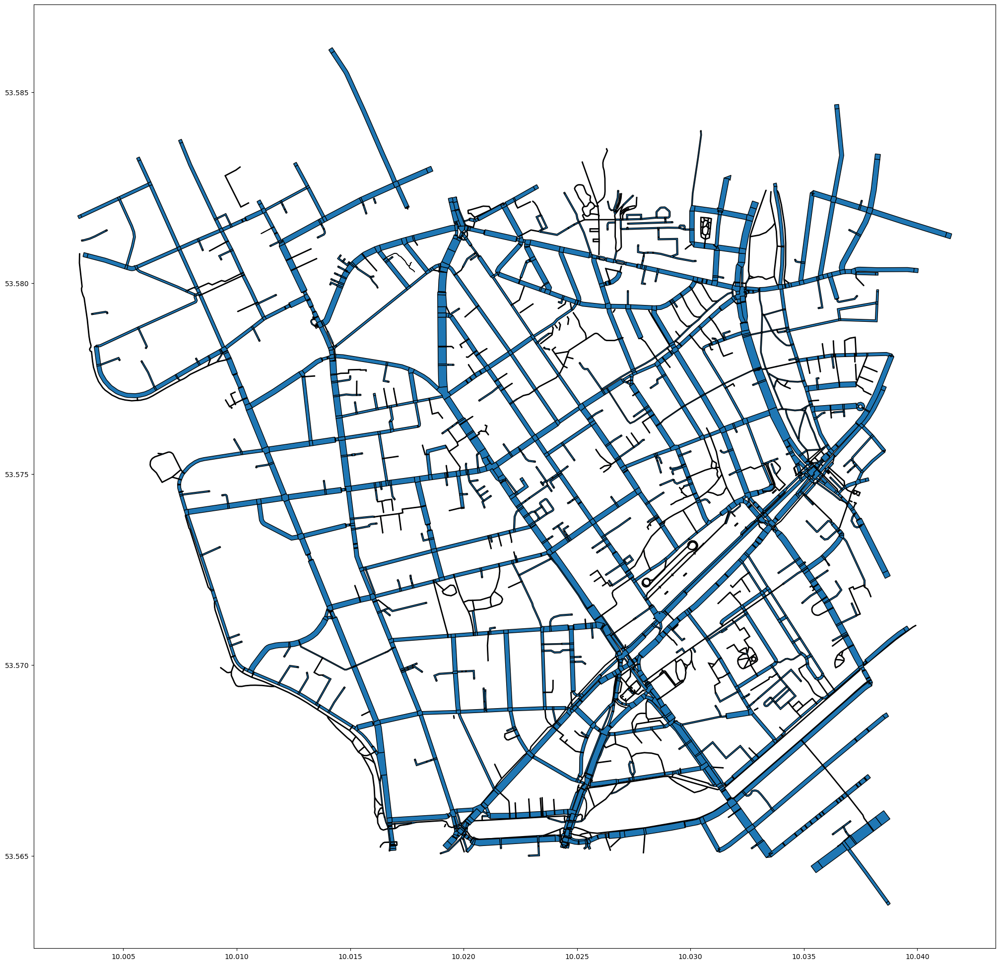

In [3]:
gdf.plot(figsize=(25, 25), edgecolor="black")

In [4]:
gdf.explore(column="type")

In [22]:
m = gdf_lanes.explore(column="type", tiles="CartoDB positron", cmap='Set1')
gdf_intersections.explore(m=m,column="type", tiles="CartoDB positron", cmap='Set1')
m